In [24]:
%store -r denver_redlining_gdf

In [42]:
import earthaccess
# allows us to use data in the crowd, crop data in the cloud, 
# so you don't have to download the whole thing
import rioxarray as rxr

In [2]:
earthaccess.login(strategy='interactive', persist=True)

In [ ]:
earthaccess.__auth__.authenticated # to check if you are really authenticated or not
#putting in wrong password really common 

True

In [5]:
help(earthaccess.search_datasets)

Help on function search_datasets in module earthaccess.api:

search_datasets(count: int = -1, **kwargs: Any) -> List[earthaccess.results.DataCollection]
    Search datasets using NASA's CMR.
    
    [https://cmr.earthdata.nasa.gov/search/site/docs/search/api.html](https://cmr.earthdata.nasa.gov/search/site/docs/search/api.html)
    
    Parameters:
        count: Number of records to get, -1 = all
        kwargs (Dict):
            arguments to CMR:
    
            * **keyword**: case-insensitive and supports wildcards ? and *
            * **short_name**: e.g. ATL08
            * **doi**: DOI for a dataset
            * **daac**: e.g. NSIDC or PODAAC
            * **provider**: particular to each DAAC, e.g. POCLOUD, LPDAAC etc.
            * **temporal**: a tuple representing temporal bounds in the form
              `(date_from, date_to)`
            * **bounding_box**: a tuple representing spatial bounds in the form
              `(lower_left_lon, lower_left_lat, upper_right_lon, 

In [25]:
ea_datasets = earthaccess.search_datasets(keyword='reflectance')

ea_datasets

[{
   "meta": {
     "revision-id": 62,
     "deleted": false,
     "format": "application/vnd.nasa.cmr.umm+json",
     "provider-id": "LPCLOUD",
     "has-combine": false,
     "user-id": "thouska",
     "has-formats": false,
     "associations": {
       "variables": [
         "V3204003817-LPCLOUD",
         "V3204003920-LPCLOUD",
         "V3204003671-LPCLOUD",
         "V3204003708-LPCLOUD",
         "V3204003748-LPCLOUD",
         "V3204003860-LPCLOUD",
         "V3204003866-LPCLOUD",
         "V3204003840-LPCLOUD",
         "V3204003828-LPCLOUD",
         "V3204003787-LPCLOUD",
         "V3204003886-LPCLOUD",
         "V3204003770-LPCLOUD",
         "V3204003902-LPCLOUD",
         "V3204003723-LPCLOUD",
         "V3204003692-LPCLOUD"
       ],
       "tools": [
         "TL1860232272-LPDAAC_ECS"
       ]
     },
     "s3-links": [
       "s3://lp-prod-protected/HLSL30.020",
       "s3://lp-prod-public/HLSL30.020"
     ],
     "has-spatial-subsetting": false,
     "native-id": "H

In [ ]:
for dataset in ea_datasets:
    print(dataset.keys())
    break

dict_keys(['meta', 'umm'])


In [15]:
for dataset in ea_datasets:
    print(dataset['meta'].keys())
    print(dataset['umm'].keys())
    break

dict_keys(['revision-id', 'deleted', 'format', 'provider-id', 'has-combine', 'user-id', 'has-formats', 'associations', 's3-links', 'has-spatial-subsetting', 'native-id', 'has-transforms', 'association-details', 'has-variables', 'concept-id', 'revision-date', 'granule-count', 'has-temporal-subsetting', 'concept-type'])
dict_keys(['TilingIdentificationSystems', 'CollectionCitations', 'AdditionalAttributes', 'SpatialExtent', 'CollectionProgress', 'ScienceKeywords', 'TemporalExtents', 'ProcessingLevel', 'DOI', 'ShortName', 'EntryTitle', 'Quality', 'DirectDistributionInformation', 'RelatedUrls', 'DataDates', 'Abstract', 'LocationKeywords', 'MetadataDates', 'VersionDescription', 'Version', 'UseConstraints', 'ContactPersons', 'CollectionDataType', 'DataCenters', 'Platforms', 'MetadataSpecification', 'ArchiveAndDistributionInformation'])


In [ ]:
# to iterate through a dictionary (see what the frick is in there)
for dataset in ea_datasets:
    print(dataset['umm']['ShortName'], dataset['umm']['EntryTitle'])

    for key, value in dataset['umm'].items():
        print(key,value)
    break

HLSL30 HLS Landsat Operational Land Imager Surface Reflectance and TOA Brightness Daily Global 30m v2.0
TilingIdentificationSystems [{'TilingIdentificationSystemName': 'Military Grid Reference System', 'Coordinate1': {'MinimumValue': '1.0', 'MaximumValue': '60'}, 'Coordinate2': {'MinimumValue': 'C', 'MaximumValue': 'W'}}]
CollectionCitations [{'Title': 'HLS Operational Land Imager Surface Reflectance and TOA Brightness Daily Global 30m v2.0', 'Creator': ' Jeffrey Masek, Junchang Ju, Jean-Claude Roger, Sergii Skakun, Eric Vermote, Martin Claverie, Jennifer Dungan, Zhangshi Yin, Brian Freitag, Chris Justice', 'ReleaseDate': '2021-08-24T00:00:00.000Z', 'Publisher': 'NASA EOSDIS Land Processes Distributed Active Archive Center', 'OtherCitationDetails': 'The DOI landing page provides citations in APA and Chicago styles.', 'OnlineResource': {'Name': 'DOI Landing Page ', 'Linkage': 'https://doi.org/10.5067/HLS/HLSL30.002'}, 'ReleasePlace': 'Sioux Falls, South Dakota, USA'}]
AdditionalAttribut

In [23]:
ea_datasets_geo = earthaccess.search_datasets(keyword='geology')

ea_datasets_geo

[{
   "meta": {
     "revision-id": 4,
     "deleted": false,
     "format": "application/vnd.nasa.cmr.umm+json",
     "provider-id": "GES_DISC",
     "has-combine": false,
     "user-id": "cloeser",
     "has-formats": false,
     "s3-links": [
       "s3://gesdisc-cumulus-prod-protected/Landslide/Global_Landslide_Exposure_Maps.1.0/"
     ],
     "has-spatial-subsetting": false,
     "native-id": "Global_Landslide_Exposure_Maps_1.0",
     "has-transforms": false,
     "has-variables": false,
     "concept-id": "C2670410720-GES_DISC",
     "revision-date": "2024-08-07T19:15:05.586Z",
     "granule-count": 8,
     "has-temporal-subsetting": false,
     "concept-type": "collection"
   },
   "umm": {
     "DataLanguage": "English",
     "AncillaryKeywords": [
       "landslide",
       "natural hazard",
       "geotiff",
       "LHASA",
       "exposure maps"
     ],
     "CollectionCitations": [
       {
         "Creator": "Robert Emberson, USRA/GESTAR/NASA GSFC",
         "Editor": "Ro

In [26]:
help(earthaccess.search_data)

Help on function search_data in module earthaccess.api:

search_data(count: int = -1, **kwargs: Any) -> List[earthaccess.results.DataGranule]
    Search dataset granules using NASA's CMR.
    
    [https://cmr.earthdata.nasa.gov/search/site/docs/search/api.html](https://cmr.earthdata.nasa.gov/search/site/docs/search/api.html)
    
    Parameters:
        count: Number of records to get, -1 = all
        kwargs (Dict):
            arguments to CMR:
    
            * **short_name**: dataset short name, e.g. ATL08
            * **version**: dataset version
            * **doi**: DOI for a dataset
            * **daac**: e.g. NSIDC or PODAAC
            * **provider**: particular to each DAAC, e.g. POCLOUD, LPDAAC etc.
            * **temporal**: a tuple representing temporal bounds in the form
              `(date_from, date_to)`
            * **bounding_box**: a tuple representing spatial bounds in the form
              `(lower_left_lon, lower_left_lat, upper_right_lon, upper_right_lat

In [28]:
denver_bounds=tuple(denver_redlining_gdf.total_bounds)

In [ ]:
ea_results = earthaccess.search_data(
    short_name = 'HLSL30',
    temporal = ("2024-10-26", "2024-10-27"),
    bounding_box = tuple(denver_redlining_gdf.total_bounds) #expecting a tuple 
)
len(ea_results) #to see how many results 

4

In [37]:
files = earthaccess.open(ea_results)

QUEUEING TASKS | :   0%|          | 0/60 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/60 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/60 [00:00<?, ?it/s]

In [ ]:
files #files in HTTPFile system behave like a file in the cloud, but are not actual files 

[<File-like object HTTPFileSystem, https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T13TDE.2024300T173719.v2.0/HLS.L30.T13TDE.2024300T173719.v2.0.SZA.tif>,
 <File-like object HTTPFileSystem, https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T13TDE.2024300T173719.v2.0/HLS.L30.T13TDE.2024300T173719.v2.0.VZA.tif>,
 <File-like object HTTPFileSystem, https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T13TDE.2024300T173719.v2.0/HLS.L30.T13TDE.2024300T173719.v2.0.B05.tif>,
 <File-like object HTTPFileSystem, https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T13TDE.2024300T173719.v2.0/HLS.L30.T13TDE.2024300T173719.v2.0.B10.tif>,
 <File-like object HTTPFileSystem, https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T13TDE.2024300T173719.v2.0/HLS.L30.T13TDE.2024300T173719.v2.0.Fmask.tif>,
 <File-like object HTTPFileSystem, https://data.lpdaac.ear

In above typically 15 bands in each "results"

In [43]:
b02_da = rxr.open_rasterio(files[6], mask_and_scale=True).squeeze()

b02_da

<xarray.DataArray (y: 3660, x: 3660)> Size: 54MB
[13395600 values with dtype=float32]
Coordinates:
    band         int32 4B 1
  * x            (x) float64 29kB 4e+05 4e+05 4e+05 ... 5.097e+05 5.097e+05
  * y            (y) float64 29kB 4.5e+06 4.5e+06 4.5e+06 ... 4.39e+06 4.39e+06
    spatial_ref  int32 4B 0
Attributes: (12/33)
    ACCODE:                    Lasrc; Lasrc
    arop_ave_xshift(meters):   0, 0
    arop_ave_yshift(meters):   0, 0
    arop_ncp:                  0, 0
    arop_rmse(meters):         0, 0
    arop_s2_refimg:            NONE
    ...                        ...
    TIRS_SSM_MODEL:            PRELIMINARY; PRELIMINARY
    TIRS_SSM_POSITION_STATUS:  ESTIMATED; ESTIMATED
    ULX:                       399960
    ULY:                       4500000
    USGS_SOFTWARE:             LPGS_16.4.0
    AREA_OR_POINT:             Area

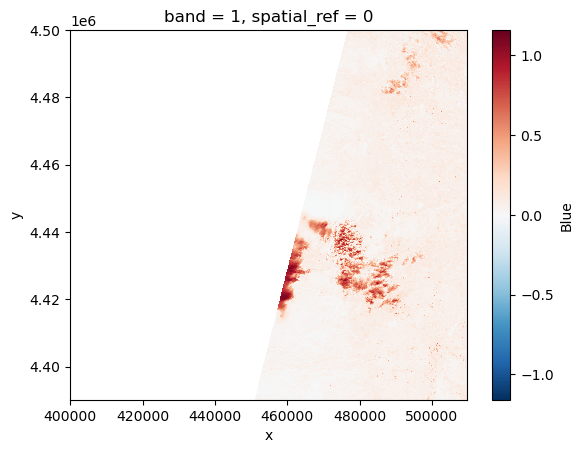

In [44]:
b02_da.plot() # at this point will download data 

In [45]:
files = earthaccess.download(ea_results, 'tmp2')

QUEUEING TASKS | :   0%|          | 0/60 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/60 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/60 [00:00<?, ?it/s]

In [ ]:
b02_da.long_name # gets long name 

'Blue'

3 ways to get file name part from a really long time  

Regular Expression 
Glob 
Split 

In [48]:
files[6].split(".")[-2]

'B02'